In [149]:
import pandas as pd
import numpy as np
from datetime import datetime, timedelta,time
import os

for one symbol

In [85]:
#df_1sec =pd.read_csv('df_1sec.csv')
df_1sec = pd.read_csv('GOOGL_1s_3_50PM_to_4_00PM.csv')
df_1sec.head()

,date,open,high,low,close,volume,average,barCount,day
0,2025-07-07 15:49:58,176.04,176.05,176.04,176.04,1425.0,176.042,12,2025-07-07
1,2025-07-07 15:49:59,176.04,176.05,176.03,176.04,1981.0,176.047,12,2025-07-07
2,2025-07-07 15:50:00,176.06,176.30,176.06,176.19,24102.0,176.193,209,2025-07-07
3,2025-07-07 15:50:01,176.20,176.21,176.18,176.19,3010.0,176.185,22,2025-07-07
4,2025-07-07 15:50:02,176.19,176.19,176.16,176.18,5698.0,176.177,42,2025-07-07


In [116]:
df_1sec.tail()

,timestamp,open,high,low,close,volume,average,barCount,day
449689,2022-07-01 15:59:55,108.71,108.74,108.67,108.74,6000.0,108.70535,3,2022-07-01
449690,2022-07-01 15:59:56,108.74,108.74,108.73,108.74,8000.0,108.73450,4,2022-07-01
449691,2022-07-01 15:59:57,108.74,108.74,108.74,108.74,0.0,108.73600,0,2022-07-01
449692,2022-07-01 15:59:58,108.71,108.71,108.68,108.70,10260.0,108.69010,4,2022-07-01
449693,2022-07-01 15:59:59,108.73,108.74,108.72,108.74,74040.0,108.73350,17,2022-07-01


In [3]:
df_1sec = df_1sec[df_1sec['day'] <= '2025-07-07']

In [115]:
df_1sec.rename(columns={'date': 'timestamp'}, inplace=True)

In [5]:
print(f"min timestamps: {df_1sec['timestamp'].min()}, max timestamps: {df_1sec['timestamp'].max()}")

min timestamps: 2022-07-01 15:49:58, max timestamps: 2025-07-07 15:59:59


DAV Calculation

In [99]:
df_90DAV= pd.read_csv('GOOGL_90DAV.csv')
df_90DAV.head()

,Datetime,Open,High,Low,Close,Volume,90_day_avg_volume
0,2021-11-12,146.75,148.85,145.41,148.68,6765460.0,9.620212e+06
1,2021-11-15,148.96,149.55,147.58,148.45,6827200.0,9.631201e+06
2,2021-11-16,148.15,148.76,147.31,147.88,4713380.0,9.617201e+06
3,2021-11-17,148.09,148.56,147.24,148.05,6317240.0,9.614927e+06
4,2021-11-18,148.24,150.58,147.88,149.84,10383900.0,9.642002e+06


In [100]:
df_90DAV.rename(columns={'Datetime': 'date'}, inplace=True)

In [101]:
df_90DAV = df_90DAV[df_90DAV['date'] >= '2022-07-01']

In [104]:
print(f"min  date: {df_90DAV['date'].min()}, max date : {df_90DAV['date'].max()}")

min  date: 2022-07-01, max date : 2025-07-07


In [ ]:
df_90DAV.tail()

getting imbalance data for one symbol

In [93]:
df_imbalance= pd.read_csv('df_imbalance.csv')
df_imbalance.head()

,ts_recv,ts_event,rtype,publisher_id,instrument_id,ref_price,auction_time,cont_book_clr_price,auct_interest_clr_price,ssr_filling_price,...,symbol,date,minutes,seconds,subseconds,90_day_avg_volume_x,90_day_avg_volume_y,90_day_avg_volume,Norm_imb,imb_sec
0,2018-05-01 15:50:00.232608214-04:00,2018-05-01 19:50:00.232589664+00:00,20,2,3363,1037.99,0,1066.62,1087.50,0.0,...,GOOGL,2018-05-01,0,0,0.232589,2.546559e+07,2.546559e+07,2.546559e+07,NaN,2018-05-01 19:50:01+00:00
1,2018-05-01 15:50:05.039544060-04:00,2018-05-01 19:50:05.039530238+00:00,20,2,3363,1038.86,0,1042.28,1048.04,0.0,...,GOOGL,2018-05-01,0,5,0.039530,2.546559e+07,2.546559e+07,2.546559e+07,NaN,2018-05-01 19:50:06+00:00
2,2018-05-01 15:50:10.081168197-04:00,2018-05-01 19:50:10.081156561+00:00,20,2,3363,1039.11,0,1042.28,1048.04,0.0,...,GOOGL,2018-05-01,0,10,0.081156,2.546559e+07,2.546559e+07,2.546559e+07,NaN,2018-05-01 19:50:11+00:00
3,2018-05-01 15:50:15.063046686-04:00,2018-05-01 19:50:15.063035041+00:00,20,2,3363,1039.11,0,1042.25,1048.04,0.0,...,GOOGL,2018-05-01,0,15,0.063035,2.546559e+07,2.546559e+07,2.546559e+07,NaN,2018-05-01 19:50:16+00:00
4,2018-05-01 15:50:20.117362819-04:00,2018-05-01 19:50:20.117352268+00:00,20,2,3363,1039.00,0,1042.20,1048.04,0.0,...,GOOGL,2018-05-01,0,20,0.117352,2.546559e+07,2.546559e+07,2.546559e+07,NaN,2018-05-01 19:50:21+00:00


In [94]:
col_names = ['90_day_avg_volume', 'Norm_imb','imb_sec','90_day_avg_volume_y','90_day_avg_volume_x']
df_imbalance = df_imbalance.drop(columns=col_names)

In [97]:
df_imbalance = df_imbalance[df_imbalance['date'] >= '2022-07-01']

In [95]:
df_imbalance.tail()

,ts_recv,ts_event,rtype,publisher_id,instrument_id,ref_price,auction_time,cont_book_clr_price,auct_interest_clr_price,ssr_filling_price,...,auction_status,freeze_status,num_extensions,unpaired_side,significant_imbalance,symbol,date,minutes,seconds,subseconds
286615,2025-07-07 15:59:50.130491096-04:00,2025-07-07 19:59:50.130324619+00:00,20,2,7152,176.75,0,176.78,176.78,0.0,...,0,0,0,N,L,GOOGL,2025-07-07,9,50,0.130324
286616,2025-07-07 15:59:51.067390364-04:00,2025-07-07 19:59:51.067224932+00:00,20,2,7152,176.75,0,176.76,176.78,0.0,...,0,0,0,N,L,GOOGL,2025-07-07,9,51,0.067224
286617,2025-07-07 15:59:52.053190674-04:00,2025-07-07 19:59:52.053025167+00:00,20,2,7152,176.75,0,176.76,176.77,0.0,...,0,0,0,N,L,GOOGL,2025-07-07,9,52,0.053025
286618,2025-07-07 15:59:53.042470074-04:00,2025-07-07 19:59:53.042304423+00:00,20,2,7152,176.72,0,176.74,176.76,0.0,...,0,0,0,N,L,GOOGL,2025-07-07,9,53,0.042304
286619,2025-07-07 15:59:54.114351878-04:00,2025-07-07 19:59:54.114186719+00:00,20,2,7152,176.72,0,176.74,176.76,0.0,...,0,0,0,N,L,GOOGL,2025-07-07,9,54,0.114186


In [98]:
print(f"min  date: {df_imbalance['date'].min()}, max date : {df_imbalance['date'].max()}")

min  date: 2022-07-01, max date : 2025-07-07


final features calculation

In [ ]:
def compute_price_move(,row):

    t_imb = row['imb_sec']  # Already in America/New_York
    print(f"the ceil is :{t_imb}")

    # Set 3:49:59 PM Eastern Time on same day
    t_ref = pd.Timestamp.combine(
        t_imb.date(), pd.Timestamp('15:49:59').time()
    ).tz_localize('America/New_York')

    print(f"the ref is :{t_ref}")

    try:
        p_imb = locals()[df_name_1sec].loc[locals()[df_name_1sec]['timestamp'] == t_imb, 'close'].iloc[0]
        p_ref = locals()[df_name_1sec].loc[locals()[df_name_1sec]['timestamp'] == t_ref, 'close'].iloc[0]

        pct_move = round(100 * (p_imb - p_ref) / p_ref, 4)

        print(f"p_imb: {p_imb}, p_ref: {p_ref}, %move: {pct_move}")

        # Return all three values
        return pd.Series({'%price_move': pct_move, 'p_imb': p_imb, 'p_ref': p_ref})

    except IndexError:
        return pd.Series({'%price_move': np.nan, 'p_imb': np.nan, 'p_ref': np.nan})


In [105]:
# Ensure date column in df_90DAV is datetime.date type
df_90DAV['date'] = pd.to_datetime(df_90DAV['date']).dt.date

# Extract date from imbalance event timestamp
df_imbalance['date'] = pd.to_datetime(df_imbalance['ts_event']).dt.date

# Merge 90DAV into imbalance dataframe based on date
df_imbalance = df_imbalance.merge(  df_90DAV,
    on=['date'],
    how='left'
)


In [106]:
df_imbalance.head()

,ts_recv,ts_event,rtype,publisher_id,instrument_id,ref_price,auction_time,cont_book_clr_price,auct_interest_clr_price,ssr_filling_price,...,date,minutes,seconds,subseconds,Open,High,Low,Close,Volume,90_day_avg_volume
0,2022-07-01 15:50:00.287065580-04:00,2022-07-01 19:50:00.287053685+00:00,20,2,4871,2174.00,0,0.0,0.0,0.0,...,2022-07-01,0,0,0.287053,107.93,109.25,106.73,108.74,11206560.0,1.132694e+07
1,2022-07-01 15:50:10.128146290-04:00,2022-07-01 19:50:10.128134321+00:00,20,2,4871,2170.05,0,0.0,0.0,0.0,...,2022-07-01,0,10,0.128134,107.93,109.25,106.73,108.74,11206560.0,1.132694e+07
2,2022-07-01 15:50:20.160310700-04:00,2022-07-01 19:50:20.160300438+00:00,20,2,4871,2171.49,0,0.0,0.0,0.0,...,2022-07-01,0,20,0.160300,107.93,109.25,106.73,108.74,11206560.0,1.132694e+07
3,2022-07-01 15:50:30.119212083-04:00,2022-07-01 19:50:30.119201763+00:00,20,2,4871,2171.25,0,0.0,0.0,0.0,...,2022-07-01,0,30,0.119201,107.93,109.25,106.73,108.74,11206560.0,1.132694e+07
4,2022-07-01 15:50:40.111066177-04:00,2022-07-01 19:50:40.111055906+00:00,20,2,4871,2170.48,0,0.0,0.0,0.0,...,2022-07-01,0,40,0.111055,107.93,109.25,106.73,108.74,11206560.0,1.132694e+07


In [107]:
print(df_imbalance['side'].unique())

['B' 'A']


this cell was used for sign earlier, dont run

In [29]:
# Clean and map side values to signed multiplier
side_sign_map = {
    'B': 1,
    'S': -1,
    'N': 0,
    'A': 0,
    'U': 0,
    '': 0,
    None: 0
}

df_imbalance['side_sign'] = df_imbalance['side'].map(side_sign_map).fillna(0)

In [30]:
# Now compute signed normalized imbalance
df_imbalance['Norm_imb'] = (
    df_imbalance['total_imbalance_qty'] * df_imbalance['side_sign']
) / df_imbalance['90_day_avg_volume']

In [108]:

# Calculate normalized imbalance (signed)
df_imbalance['Norm_imb'] = (
    df_imbalance['total_imbalance_qty'] * df_imbalance['side'].map({'B': 1, 'A': -1})
) / df_imbalance['90_day_avg_volume']



In [109]:
# Checking how many rows in df_imbalance have a negative value for a column col_name
negative_count = (df_imbalance['Norm_imb'] < 0).sum()
print(f"Number of rows with negative values in column 'Norm_imb': {negative_count}")

# Checking how many rows in df_imbalance have a value equal to x
equal_to_x_count = (df_imbalance['side'] == 'A').sum()
print(f"Number of rows with value equal to 'S' in column 'side': {equal_to_x_count}")

print(f"length of df_imbalance :{len(df_imbalance)}")

Number of rows with negative values in column 'Norm_imb': 79865
Number of rows with value equal to 'S' in column 'side': 79865
length of df_imbalance :149897


In [110]:
# Make sure ts_event is parsed as timezone-aware datetime
df_imbalance['ts_event'] = pd.to_datetime(df_imbalance['ts_event'], utc=True)

# Convert the entire ts_event column to US Eastern Time
df_imbalance['ts_event'] = df_imbalance['ts_event'].dt.tz_convert('America/New_York')


In [111]:
print(df_imbalance['ts_event'].dt.tz)

America/New_York


In [112]:
df_imbalance.head()

,ts_recv,ts_event,rtype,publisher_id,instrument_id,ref_price,auction_time,cont_book_clr_price,auct_interest_clr_price,ssr_filling_price,...,minutes,seconds,subseconds,Open,High,Low,Close,Volume,90_day_avg_volume,Norm_imb
0,2022-07-01 15:50:00.287065580-04:00,2022-07-01 15:50:00.287053685-04:00,20,2,4871,2174.00,0,0.0,0.0,0.0,...,0,0,0.287053,107.93,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002434
1,2022-07-01 15:50:10.128146290-04:00,2022-07-01 15:50:10.128134321-04:00,20,2,4871,2170.05,0,0.0,0.0,0.0,...,0,10,0.128134,107.93,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002482
2,2022-07-01 15:50:20.160310700-04:00,2022-07-01 15:50:20.160300438-04:00,20,2,4871,2171.49,0,0.0,0.0,0.0,...,0,20,0.160300,107.93,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002457
3,2022-07-01 15:50:30.119212083-04:00,2022-07-01 15:50:30.119201763-04:00,20,2,4871,2171.25,0,0.0,0.0,0.0,...,0,30,0.119201,107.93,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002452
4,2022-07-01 15:50:40.111066177-04:00,2022-07-01 15:50:40.111055906-04:00,20,2,4871,2170.48,0,0.0,0.0,0.0,...,0,40,0.111055,107.93,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002461


In [113]:
df_imbalance['imb_sec'] = df_imbalance['ts_event'].dt.ceil('1s')
print(df_imbalance['imb_sec'].dt.tz)


America/New_York


In [117]:
df_1sec['timestamp'] = pd.to_datetime(df_1sec['timestamp'], errors='coerce')  # Parse safely
df_1sec['timestamp'] = df_1sec['timestamp'].dt.tz_localize('America/New_York')  # Tag as ET
print(df_1sec['timestamp'].dt.tz)  # should print something like tzoffset or pytz object
print(df_1sec['timestamp'].head())


In [119]:
df_1sec.head()

,timestamp,open,high,low,close,volume,average,barCount,day
0,2025-07-07 15:49:58-04:00,176.04,176.05,176.04,176.04,1425.0,176.042,12,2025-07-07
1,2025-07-07 15:49:59-04:00,176.04,176.05,176.03,176.04,1981.0,176.047,12,2025-07-07
2,2025-07-07 15:50:00-04:00,176.06,176.30,176.06,176.19,24102.0,176.193,209,2025-07-07
3,2025-07-07 15:50:01-04:00,176.20,176.21,176.18,176.19,3010.0,176.185,22,2025-07-07
4,2025-07-07 15:50:02-04:00,176.19,176.19,176.16,176.18,5698.0,176.177,42,2025-07-07


In [120]:
def compute_price_move(row):
    t_imb = row['imb_sec']  # Already in America/New_York
    print(f"the ceil is :{t_imb}")

    # Set 3:49:59 PM Eastern Time on same day
    t_ref = pd.Timestamp.combine(
        t_imb.date(), pd.Timestamp('15:49:59').time()
    ).tz_localize('America/New_York')

    print(f"the ref is :{t_ref}")

    try:
        p_imb = df_1sec.loc[df_1sec['timestamp'] == t_imb, 'close'].iloc[0]
        p_ref = df_1sec.loc[df_1sec['timestamp'] == t_ref, 'close'].iloc[0]

        pct_move = round(100 * (p_imb - p_ref) / p_ref, 4)

        print(f"p_imb: {p_imb}, p_ref: {p_ref}, %move: {pct_move}")

        # Return all three values
        return pd.Series({'%price_move': pct_move, 'p_imb': p_imb, 'p_ref': p_ref})

    except IndexError:
        return pd.Series({'%price_move': np.nan, 'p_imb': np.nan, 'p_ref': np.nan})


In [121]:
df_imbalance[['%price_move', 'p_imb', 'p_ref']] = df_imbalance.apply(compute_price_move, axis=1)


the ceil is :2022-07-01 15:50:01-04:00
the ref is :2022-07-01 15:49:59-04:00
p_imb: 108.58, p_ref: 108.66, %move: -0.0736
the ceil is :2022-07-01 15:50:11-04:00
the ref is :2022-07-01 15:49:59-04:00
p_imb: 108.52, p_ref: 108.66, %move: -0.1288
the ceil is :2022-07-01 15:50:21-04:00
the ref is :2022-07-01 15:49:59-04:00
p_imb: 108.53, p_ref: 108.66, %move: -0.1196
the ceil is :2022-07-01 15:50:31-04:00
the ref is :2022-07-01 15:49:59-04:00
p_imb: 108.53, p_ref: 108.66, %move: -0.1196
the ceil is :2022-07-01 15:50:41-04:00
the ref is :2022-07-01 15:49:59-04:00
p_imb: 108.53, p_ref: 108.66, %move: -0.1196
the ceil is :2022-07-01 15:50:51-04:00
the ref is :2022-07-01 15:49:59-04:00
p_imb: 108.42, p_ref: 108.66, %move: -0.2209
the ceil is :2022-07-01 15:51:01-04:00
the ref is :2022-07-01 15:49:59-04:00
p_imb: 108.4, p_ref: 108.66, %move: -0.2393
the ceil is :2022-07-01 15:51:11-04:00
the ref is :2022-07-01 15:49:59-04:00
p_imb: 108.39, p_ref: 108.66, %move: -0.2485
the ceil is :2022-07-01 1

In [122]:
df_imbalance.to_csv('df_imbalance_finalised_GOOGL_initial.csv', index=False)

benefits of preprocessing

In [166]:
df_imbalance =pd.read_csv('df_imbalance_finalised_GOOGL_ind.csv')

In [167]:
df_imbalance.head()

,ts_recv,ts_event,rtype,publisher_id,instrument_id,ref_price,auction_time,cont_book_clr_price,auct_interest_clr_price,ssr_filling_price,...,High,Low,Close,Volume,90_day_avg_volume,Norm_imb,imb_sec,%price_move,p_imb,p_ref
0,2022-07-01 15:50:00.287065580-04:00,2022-07-01 15:50:00.287053685-04:00,20,2,4871,2174.00,0,0.0,0.0,0.0,...,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002434,2022-07-01 15:50:01-04:00,-0.0736,108.58,108.66
1,2022-07-01 15:50:10.128146290-04:00,2022-07-01 15:50:10.128134321-04:00,20,2,4871,2170.05,0,0.0,0.0,0.0,...,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002482,2022-07-01 15:50:11-04:00,-0.1288,108.52,108.66
2,2022-07-01 15:50:20.160310700-04:00,2022-07-01 15:50:20.160300438-04:00,20,2,4871,2171.49,0,0.0,0.0,0.0,...,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002457,2022-07-01 15:50:21-04:00,-0.1196,108.53,108.66
3,2022-07-01 15:50:30.119212083-04:00,2022-07-01 15:50:30.119201763-04:00,20,2,4871,2171.25,0,0.0,0.0,0.0,...,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002452,2022-07-01 15:50:31-04:00,-0.1196,108.53,108.66
4,2022-07-01 15:50:40.111066177-04:00,2022-07-01 15:50:40.111055906-04:00,20,2,4871,2170.48,0,0.0,0.0,0.0,...,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002461,2022-07-01 15:50:41-04:00,-0.1196,108.53,108.66


In [168]:
df_imbalance_cpy= df_imbalance.copy()

In [169]:
df_imbalance.shape

(149897, 40)

In [170]:
df_imbalance_cpy.columns

Index(['ts_recv', 'ts_event', 'rtype', 'publisher_id', 'instrument_id',
       'ref_price', 'auction_time', 'cont_book_clr_price',
       'auct_interest_clr_price', 'ssr_filling_price', 'ind_match_price',
       'upper_collar', 'lower_collar', 'paired_qty', 'total_imbalance_qty',
       'market_imbalance_qty', 'unpaired_qty', 'auction_type', 'side',
       'auction_status', 'freeze_status', 'num_extensions', 'unpaired_side',
       'significant_imbalance', 'symbol', 'date', 'minutes', 'seconds',
       'subseconds', 'Open', 'High', 'Low', 'Close', 'Volume',
       '90_day_avg_volume', 'Norm_imb', 'imb_sec', '%price_move', 'p_imb',
       'p_ref'],
      dtype='object')

In [171]:
df_imbalance_cpy.dtypes

ts_recv                     object
ts_event                    object
rtype                        int64
publisher_id                 int64
instrument_id                int64
ref_price                  float64
auction_time                 int64
cont_book_clr_price        float64
auct_interest_clr_price    float64
ssr_filling_price          float64
ind_match_price            float64
upper_collar               float64
lower_collar               float64
paired_qty                   int64
total_imbalance_qty          int64
market_imbalance_qty         int64
unpaired_qty                 int64
auction_type                object
side                        object
auction_status               int64
freeze_status                int64
num_extensions               int64
unpaired_side               object
significant_imbalance       object
symbol                      object
date                        object
minutes                      int64
seconds                      int64
subseconds          

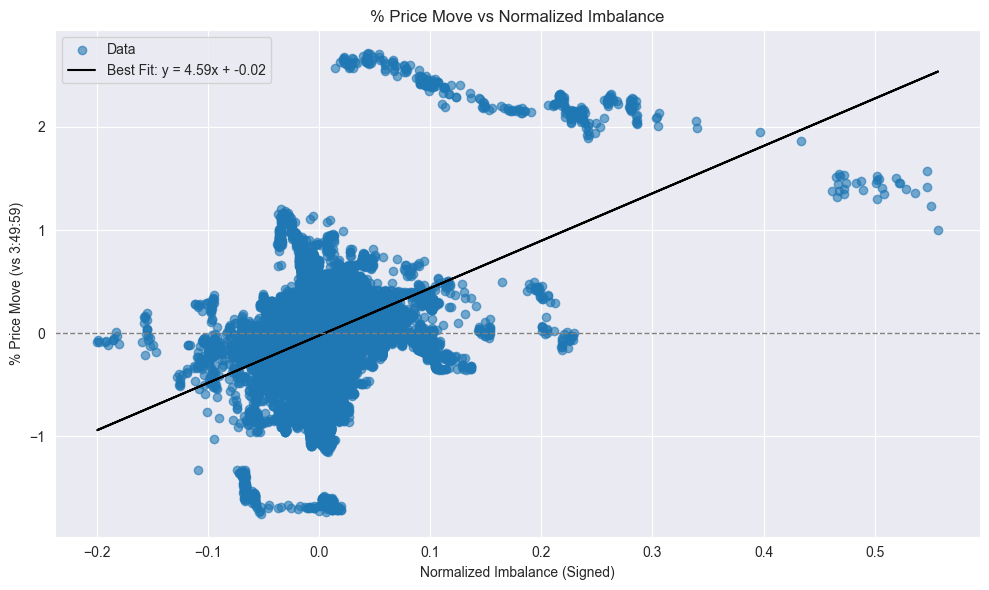

In [172]:
import numpy as np
import matplotlib.pyplot as plt

# Drop NaNs
df_plot = df_imbalance_cpy.dropna(subset=['Norm_imb', '%price_move'])

# Extract x and y
x = df_plot['Norm_imb']
y = df_plot['%price_move']

# Fit a straight line: y = m*x + b
m, b = np.polyfit(x, y, 1)

# Plot scatter and best fit line
plt.figure(figsize=(10, 6))
plt.scatter(x, y, alpha=0.6, label='Data')
plt.plot(x, m*x + b, color='black', label=f'Best Fit: y = {m:.2f}x + {b:.2f}')
plt.axhline(0, color='gray', linestyle='--', linewidth=1)
plt.xlabel('Normalized Imbalance (Signed)')
plt.ylabel('% Price Move (vs 3:49:59)')
plt.title('% Price Move vs Normalized Imbalance')
plt.legend()
plt.tight_layout()
plt.show()


In [173]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import numpy as np

# Sample data (replace with your actual data)
x = df_plot['Norm_imb'].values
y = df_plot['%price_move']

x = x.reshape(-1, 1)
# Create and fit the model
model = LinearRegression()
model.fit(x, y)

# Make predictions
y_pred = model.predict(x)

# Calculate R-squared
r2 = r2_score(y, y_pred)

print(f"R-squared: {r2}")

R-squared: 0.11476077451584099


In [132]:
import numpy as np
from sklearn.metrics import r2_score

# Example usage:
y_true = df_plot['Norm_imb']
y_pred = df_plot['%price_move']

r_squared = r2_score(y_true, y_pred)
print(f"R-squared: {r_squared}")

R-squared: -175.83954732324597


In [133]:
df_imbalance_cpy['date'] = pd.to_datetime(df_imbalance_cpy['date'])


In [134]:
df_first_per_day = df_imbalance_cpy.sort_values('ts_event').groupby(df_imbalance_cpy['date'].dt.date).head(1)


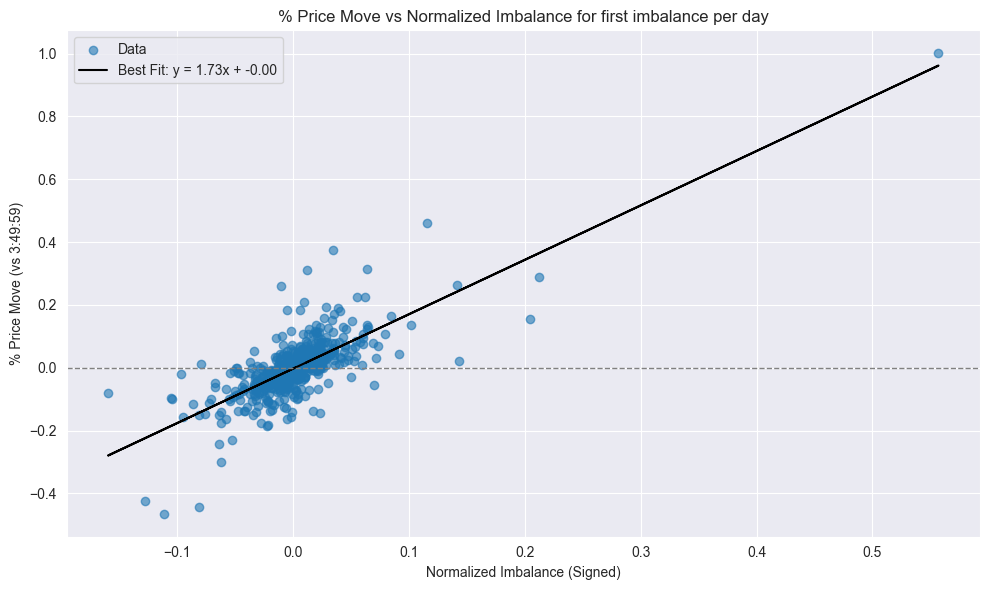

In [181]:
import numpy as np
import matplotlib.pyplot as plt

# Drop NaNs
df_plot = df_first_per_day.dropna(subset=['Norm_imb', '%price_move'])

# Extract x and y
x = df_plot['Norm_imb']
y = df_plot['%price_move']

# Fit a straight line: y = m*x + b
m, b = np.polyfit(x, y, 1)

# # Calculate limits for zooming in (50% closer to the origin)
# x_min, x_max = x.min(), x.max()
# y_min, y_max = y.min(), y.max()
#
# x_range = x_max - x_min
# y_range = y_max - y_min
#
# x_new_min = x_min #+ 0.25 * x_range
# x_new_max = x_max - 0.5 * x_range
# y_new_min = y_min #+ 0.25 * y_range
# y_new_max = y_max - 0.25 * y_range

# Plot scatter and best fit line
plt.figure(figsize=(10, 6))
plt.scatter(x, y, alpha=0.6, label='Data')
plt.plot(x, m*x + b, color='black', label=f'Best Fit: y = {m:.2f}x + {b:.2f}')
plt.axhline(0, color='gray', linestyle='--', linewidth=1)
plt.xlabel('Normalized Imbalance (Signed)')
plt.ylabel('% Price Move (vs 3:49:59)')
plt.title('% Price Move vs Normalized Imbalance for first imbalance per day')

# # Set new axis limits
# plt.xlim(x_new_min, x_new_max)
# plt.ylim(y_new_min, y_new_max)

plt.legend()
plt.tight_layout()
plt.show()

In [183]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import numpy as np

# Sample data (replace with your actual data)
x = df_plot['Norm_imb'].values
y = df_plot['%price_move']

x = x.reshape(-1, 1)
# Create and fit the model
model = LinearRegression()
model.fit(x, y)

# Make predictions
y_pred = model.predict(x)

# Calculate R-squared
r2 = r2_score(y, y_pred)

print(f"R-squared: {r2}")

R-squared: 0.5724817001614168


In [174]:
df_imbalance_cpy.head()

,ts_recv,ts_event,rtype,publisher_id,instrument_id,ref_price,auction_time,cont_book_clr_price,auct_interest_clr_price,ssr_filling_price,...,High,Low,Close,Volume,90_day_avg_volume,Norm_imb,imb_sec,%price_move,p_imb,p_ref
0,2022-07-01 15:50:00.287065580-04:00,2022-07-01 15:50:00.287053685-04:00,20,2,4871,2174.00,0,0.0,0.0,0.0,...,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002434,2022-07-01 15:50:01-04:00,-0.0736,108.58,108.66
1,2022-07-01 15:50:10.128146290-04:00,2022-07-01 15:50:10.128134321-04:00,20,2,4871,2170.05,0,0.0,0.0,0.0,...,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002482,2022-07-01 15:50:11-04:00,-0.1288,108.52,108.66
2,2022-07-01 15:50:20.160310700-04:00,2022-07-01 15:50:20.160300438-04:00,20,2,4871,2171.49,0,0.0,0.0,0.0,...,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002457,2022-07-01 15:50:21-04:00,-0.1196,108.53,108.66
3,2022-07-01 15:50:30.119212083-04:00,2022-07-01 15:50:30.119201763-04:00,20,2,4871,2171.25,0,0.0,0.0,0.0,...,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002452,2022-07-01 15:50:31-04:00,-0.1196,108.53,108.66
4,2022-07-01 15:50:40.111066177-04:00,2022-07-01 15:50:40.111055906-04:00,20,2,4871,2170.48,0,0.0,0.0,0.0,...,109.25,106.73,108.74,11206560.0,1.132694e+07,0.002461,2022-07-01 15:50:41-04:00,-0.1196,108.53,108.66


In [178]:
df_plot = df_first_per_day.dropna(subset=['Norm_imb','Close','p_ref'])

C:\Users\PC\AppData\Local\Temp\ipykernel_16956\88946559.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_plot['pct_move_10min'] = df_plot['Close'] /df_plot['p_ref'] -1


check size of x and y : 497 497


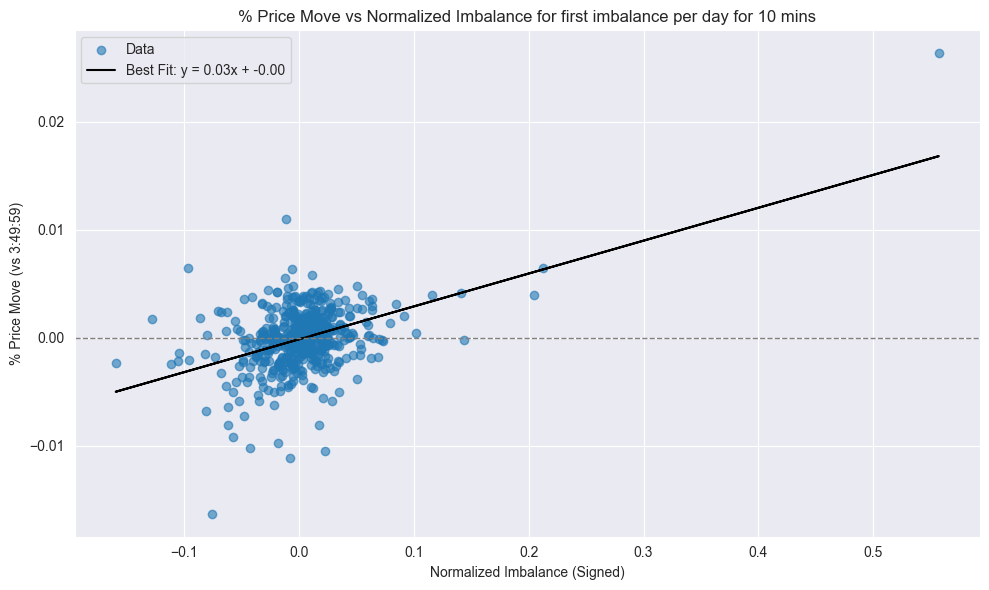

In [179]:
import numpy as np
import matplotlib.pyplot as plt


df_plot['pct_move_10min'] = df_plot['Close'] /df_plot['p_ref'] -1


# Extract x and y
x = df_plot['Norm_imb']
y = df_plot['pct_move_10min']

print("check size of x and y :",len(x),len(y))


# Fit a straight line: y = m*x + b
m, b = np.polyfit(x, y, 1)

# # Calculate limits for zooming in (50% closer to the origin)
# x_min, x_max = x.min(), x.max()
# y_min, y_max = y.min(), y.max()
#
# x_range = x_max - x_min
# y_range = y_max - y_min
#
# x_new_min = x_min #+ 0.25 * x_range
# x_new_max = x_max - 0.5 * x_range
# y_new_min = y_min #+ 0.25 * y_range
# y_new_max = y_max - 0.25 * y_range

# Plot scatter and best fit line
plt.figure(figsize=(10, 6))
plt.scatter(x, y, alpha=0.6, label='Data')
plt.plot(x, m*x + b, color='black', label=f'Best Fit: y = {m:.2f}x + {b:.2f}')
plt.axhline(0, color='gray', linestyle='--', linewidth=1)
plt.xlabel('Normalized Imbalance (Signed)')
plt.ylabel('% Price Move (vs 3:49:59)')
plt.title('% Price Move vs Normalized Imbalance for first imbalance per day for 10 mins')

# # Set new axis limits
# plt.xlim(x_new_min, x_new_max)
# plt.ylim(y_new_min, y_new_max)

plt.legend()
plt.tight_layout()
plt.show()

In [180]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import numpy as np

# Sample data (replace with your actual data)
x = df_plot['Norm_imb'].values
y = df_plot['pct_move_10min']

x = x.reshape(-1, 1)
# Create and fit the model
model = LinearRegression()
model.fit(x, y)

# Make predictions
y_pred = model.predict(x)

# Calculate R-squared
r2 = r2_score(y, y_pred)

print(f"R-squared: {r2}")

R-squared: 0.20096345215983458


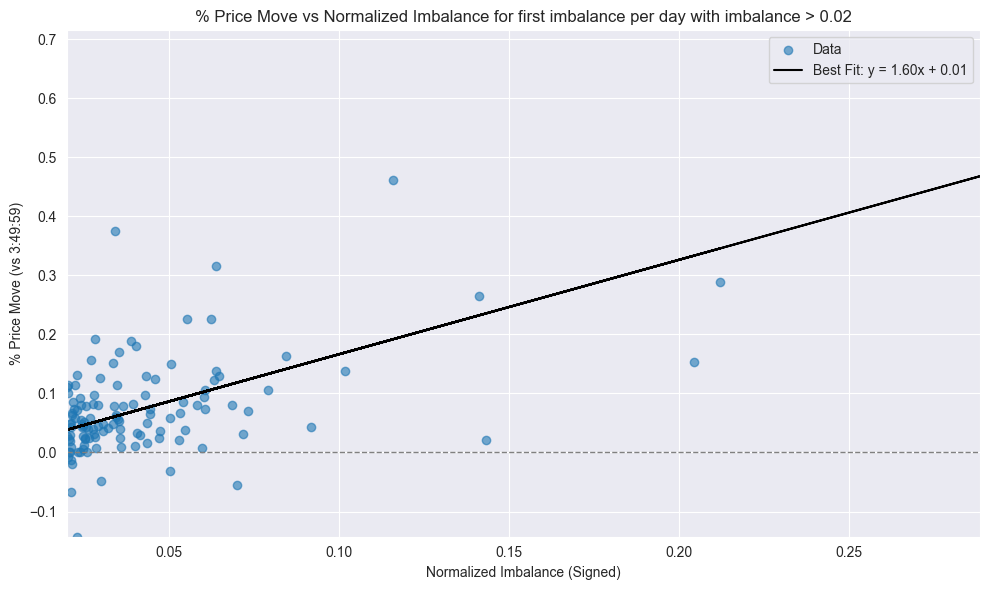

In [137]:
import numpy as np
import matplotlib.pyplot as plt

# Drop NaNs
df_plot = df_first_per_day.dropna(subset=['Norm_imb', '%price_move'])

# Extract x and y

new_df =df_plot[df_plot['Norm_imb']>=0.02]
y = new_df['%price_move']
x=new_df['Norm_imb']

# Fit a straight line: y = m*x + b
m, b = np.polyfit(x, y, 1)

# Calculate limits for zooming in (50% closer to the origin)
x_min, x_max = x.min(), x.max()
y_min, y_max = y.min(), y.max()

x_range = x_max - x_min
y_range = y_max - y_min

x_new_min = x_min #+ 0.25 * x_range
x_new_max = x_max - 0.5 * x_range
y_new_min = y_min #+ 0.25 * y_range
y_new_max = y_max - 0.25 * y_range

# Plot scatter and best fit line
plt.figure(figsize=(10, 6))
plt.scatter(x, y, alpha=0.6, label='Data')
plt.plot(x, m*x + b, color='black', label=f'Best Fit: y = {m:.2f}x + {b:.2f}')
plt.axhline(0, color='gray', linestyle='--', linewidth=1)
plt.xlabel('Normalized Imbalance (Signed)')
plt.ylabel('% Price Move (vs 3:49:59)')
plt.title('% Price Move vs Normalized Imbalance for first imbalance per day with imbalance > 0.02')

# Set new axis limits
plt.xlim(x_new_min, x_new_max)
plt.ylim(y_new_min, y_new_max)

plt.legend()
plt.tight_layout()
plt.show()

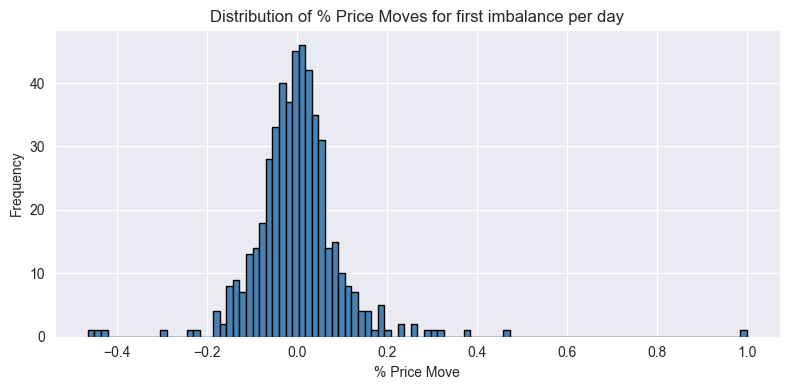

In [138]:
plt.figure(figsize=(8, 4))
plt.hist(df_first_per_day['%price_move'].dropna(), bins=100, color='steelblue', edgecolor='black')
plt.xlabel('% Price Move')
plt.ylabel('Frequency')
plt.title('Distribution of % Price Moves for first imbalance per day')
plt.grid(True)
plt.tight_layout()
plt.show()


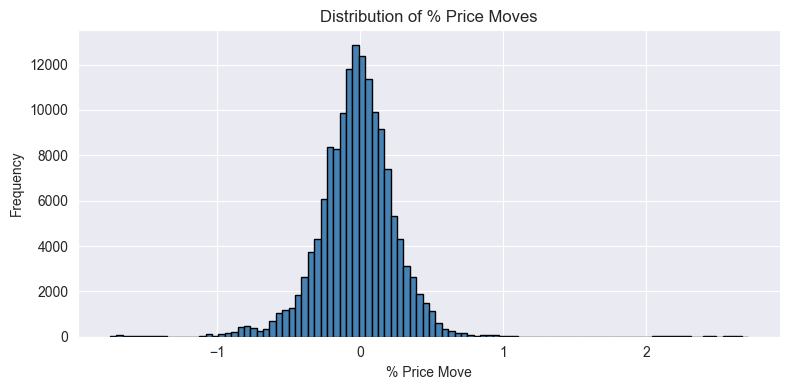

In [141]:
plt.figure(figsize=(8, 4))
plt.hist(df_imbalance['%price_move'].dropna(), bins=100, color='steelblue', edgecolor='black')
plt.xlabel('% Price Move')
plt.ylabel('Frequency')
plt.title('Distribution of % Price Moves')
plt.grid(True)
plt.tight_layout()
plt.show()


In [142]:
df_first_per_day['%price_move'].describe()

count    497.000000
mean       0.000210
std        0.100246
min       -0.464800
25%       -0.047600
50%        0.000000
75%        0.041100
max        1.000300
Name: %price_move, dtype: float64

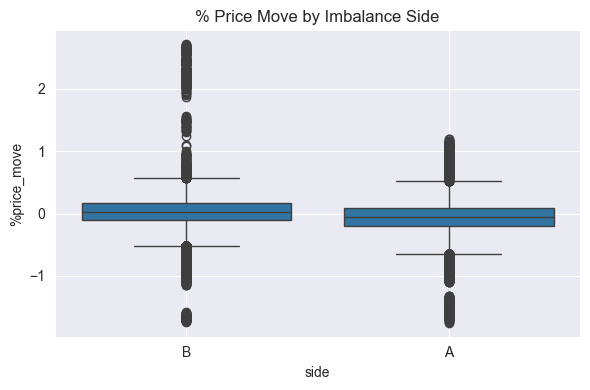

In [143]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(6, 4))
sns.boxplot(data=df_imbalance, x='side', y='%price_move')
plt.title('% Price Move by Imbalance Side')
plt.grid(True)
plt.tight_layout()
plt.show()


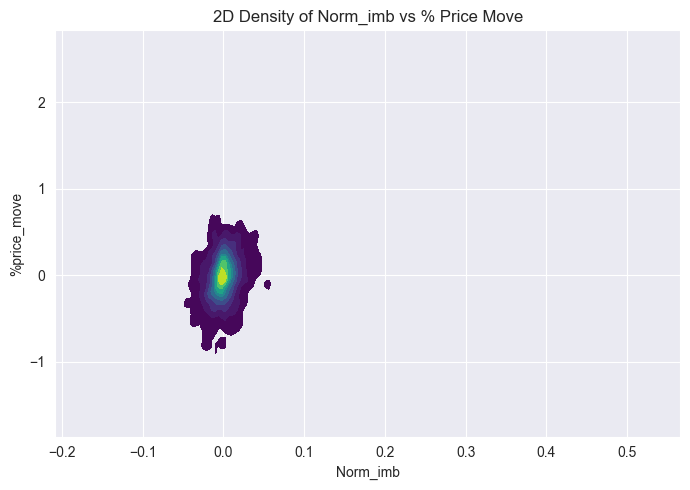

In [144]:
plt.figure(figsize=(7, 5))
sns.kdeplot(
    data=df_imbalance, x='Norm_imb', y='%price_move',
    fill=True, cmap='viridis', thresh=0.05
)
plt.title('2D Density of Norm_imb vs % Price Move')
plt.grid(True)
plt.tight_layout()
plt.show()


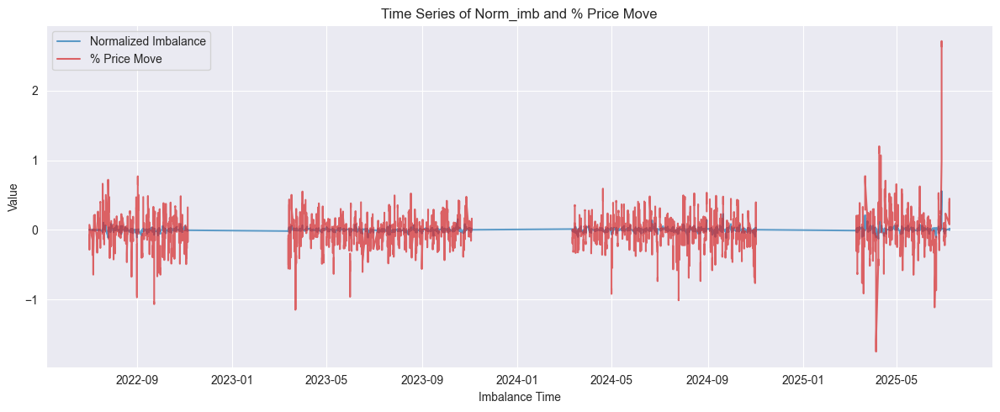

In [145]:
import matplotlib.pyplot as plt

# Ensure the dataframe is sorted by timestamp
df_sorted = df_imbalance.sort_values('imb_sec')

plt.figure(figsize=(12, 5))

# Plot Normalized Imbalance
plt.plot(df_sorted['imb_sec'], df_sorted['Norm_imb'], label='Normalized Imbalance', color='tab:blue', alpha=0.7)

# Plot % Price Move on secondary y-axis
plt.plot(df_sorted['imb_sec'], df_sorted['%price_move'], label='% Price Move', color='tab:red', alpha=0.7)

plt.xlabel('Imbalance Time')
plt.ylabel('Value')
plt.title('Time Series of Norm_imb and % Price Move')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


<Axes: xlabel='X data', ylabel='Y1 data'>

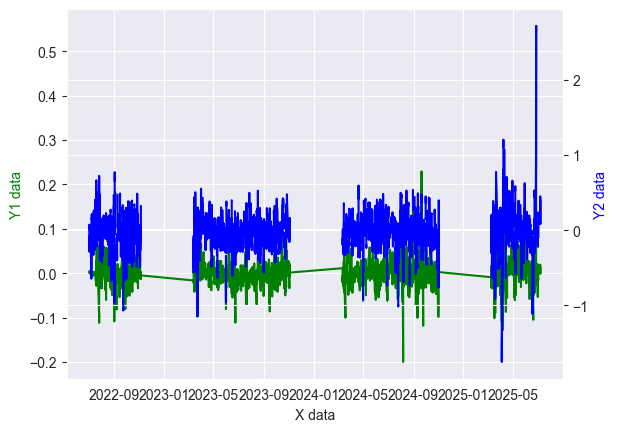

In [146]:
# Sample data
x = df_sorted['imb_sec']
y1 =df_sorted['Norm_imb']
y2 = df_sorted['%price_move']

# Create the figure and primary axes
fig, ax1 = plt.subplots()

# Create the secondary axes sharing the x-axis
ax2 = ax1.twinx()

# Plot data on respective axes
ax1.plot(x, y1, 'g-', label='Primary Data')
ax2.plot(x, y2, 'b-', label='Secondary Data')

# Set labels and title
ax1.set_xlabel('X data')
ax1.set_ylabel('Y1 data', color='g')
ax2.set_ylabel('Y2 data', color='b')
ax1

In [57]:
df_amzn = pd.read_csv('AMZN_imbalance.csv')

In [59]:
print(df_amzn['side'].unique())

['A' 'B']


In [58]:
df_aapl = pd.read_csv('AAPL_imbalance.csv')

In [60]:
print(df_aapl['side'].unique())

['B' 'A']


In [ ]:
for symbol in symbols:
    df_name_imb = f"df_imbalance_{symbol}"
    df_name_90DAV = f"df_1day_{symbol}"
    df_name_1sec = f"df_1sec_{symbol}"
    df_name_final = f"df_imbalance_finalised_{symbol}"
    locals()[df_name_imb][['%price_move', 'p_imb', 'p_ref']] = locals()[df_name_imb].apply(compute_price_move, axis=1)
    locals()[df_name_imb].to_csv(locals()[df_name_final]+'.csv', index=False)

